In [ ]:
import re
from nltk.tokenize import sent_tokenize, word_tokenize
import nltk
from spacy.lang.en.stop_words import STOP_WORDS
import pandas as pd
from nltk.corpus import stopwords
from string import punctuation
from spacy.lang.en.stop_words import STOP_WORDS
from nltk.util import ngrams
from wordcloud import WordCloud, STOPWORDS
from nltk import PorterStemmer
import math
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sumy.nlp.stemmers import Stemmer
from sumy.summarizers.lex_rank import LexRankSummarizer 
from sumy.parsers.plaintext import PlaintextParser
from sumy.nlp.tokenizers import Tokenizer
from sumy.utils import get_stop_words
from rouge import Rouge
import matplotlib.pyplot as plt

In [ ]:
f=open('The-Curse-of-Kalathan.txt','r',encoding='utf-8', errors='ignore')

In [ ]:
text=f.read()

In [ ]:
text

' \n\n\n\n\nThe Curse of Kalathan\n\x0c\nTrina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life.\nTheo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land.\n\x0c\nPrologue\nKalathan. Still, when I say the name of my country my heart swells. What is it, that makes me love the land of my birth? How can a land, an inanimate land, inspire

In [ ]:
#import fitz  # this is pymupdf

#with fitz.open("The-Curse-of-Kalathan.pdf") as doc:
#    text = ""
#    for page in doc:
#        text += page.get_text()

#print(text)

In [ ]:
ds                   = pd.DataFrame()
ds['Corpus Length']  = pd.DataFrame([[len(text)]])
ds['Corpus']         = pd.DataFrame([[text]])

In [ ]:
text =re.sub("\n"," ",text)
text = re.sub("\x0c"," ",text)
text = re.sub(r'Chapter \d+'," ",text)
text = re.sub("Prologue"," ",text)
text= re.sub(r'• • • •',' ',text)
text = re.sub(r'\s+',' ',text)
text

' The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life. Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. Kalathan. Still, when I say the name of my country my heart swells. What is it, that makes me love the land of my birth? How can a land, an inanimate land, inspire such loyalty and fierce devotion i

In [ ]:
ds['Cleaned Corpus']         = pd.DataFrame([[text]]) 
ds['Cleaned Corpus length']  = pd.DataFrame([[len(text)]])

print("corpus length =",len(text))
text

corpus length = 522550


' The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life. Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. Kalathan. Still, when I say the name of my country my heart swells. What is it, that makes me love the land of my birth? How can a land, an inanimate land, inspire such loyalty and fierce devotion i

In [ ]:
ds

,Corpus Length,Corpus,Cleaned Corpus,Cleaned Corpus length
0,523565,\n\n\n\n\nThe Curse of Kalathan\n \nTrina has...,The Curse of Kalathan Trina has been thrown i...,522550


# Exploratory Data Analysis(EDA)

### Using Spacy & NLTK

In [ ]:
from nltk import sent_tokenize
import spacy
from spacy import displacy

In [ ]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\sande\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\sande\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sande\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [ ]:
list_sentences = sent_tokenize(text)
print("Total no of sentences = ",len(list_sentences),"\n")
list_10 = list_sentences[0:10]
list_10

Total no of sentences =  7942 



[' The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is.',
 'What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life.',
 'Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time.',
 'But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land.',
 'Kalathan.',
 'Still, when I say the name of my country my heart swells.',
 'What is it, that makes me love the land of my birth?',
 'How can a land, an inanimate land, inspire such 

In [ ]:
ner = spacy.load('en_core_web_sm')

for i in range(50,88):
    one_sent = list_sentences[i]
    doc_block = ner(one_sent)
    displacy.render(doc_block, style='ent',  jupyter=True)  

D:\user\sandeep\envs\virtual\lib\site-packages\spacy\displacy\__init__.py:200: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  warnings.warn(Warnings.W006)


In [ ]:
colNames = ['TEXT', 'LABEL', 'MEANING'] 
Entities_table = pd.DataFrame() #initialising dataframe

ner = spacy.load('en_core_web_sm')
ner_data = ner(text)
for word in ner_data.ents:
    varLabelValue =  word.label_
    varLabelMeaning = spacy.explain(varLabelValue)
    Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
                                                        columns = colNames))
    #print(word.text, word.label_, word.lemma_)
    
    
Entities_table.reset_index(drop=True)

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  Entities_table = Entities_table.append(pd.DataFrame(data=[[word.text, word.label_, varLabelMeaning]],
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1709059531.py:9: FutureWarning: The fr

,TEXT,LABEL,MEANING
0,Kalathan Trina,PERSON,"People, including fictional"
1,Kalathan,GPE,"Countries, cities, states"
2,six,CARDINAL,Numerals that do not fall under another type
3,Trina,GPE,"Countries, cities, states"
4,Kalathan,GPE,"Countries, cities, states"
...,...,...,...
3915,Grigor,PERSON,"People, including fictional"
3916,Jameth,PERSON,"People, including fictional"
3917,Jandrin,PERSON,"People, including fictional"
3918,Hadrus,ORG,"Companies, agencies, institutions, etc."


In [ ]:
# POS and Dependency on entire corpus (string)
#creating table with all values
#creating noun and verb dictionary with key as text and values as their frequency

colnames = ['TEXT', 'LEMMA', 'POS','TAGS','DEP','ALPHA','STOP']
tags_pos_table = pd.DataFrame()

noun_frequencies = {} # dictionary intialization for noun
verb_frequencies = {} # dictionary intialization for verb

nlp = spacy.load('en_core_web_sm')
ner_data = nlp(text)
for token in ner_data:
    tags_pos_table = tags_pos_table.append(pd.DataFrame(
        data=[[token.text,token.lemma_,token.pos_, token.tag_, token.dep_,token.is_alpha,token.is_stop]],
                         columns = colnames))
        #print(token.text, token.lemma_, token.pos_, token.tag_, token.dep_,token.is_alpha, token.is_stop)
    
    #create dictionary of noun frequencies
    if token.pos_ == 'NOUN':
        if token.text not in noun_frequencies.keys():
            noun_frequencies[token.text] = 1
        else:    
            noun_frequencies[token.text] +=1 
    
    #creates dictionary of verb frequencies        
    if token.pos_ == 'VERB':
        if token.text not in verb_frequencies.keys():
            verb_frequencies[token.text] = 1
        else:    
            verb_frequencies[token.text] +=1                        
                
tags_pos_table.reset_index(drop=True, inplace=True)
print(tags_pos_table.shape)
tags_pos_table.head(20)

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

(115787, 7)


C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_table.append(pd.DataFrame(
C:\Users\sande\AppData\Local\Temp\ipykernel_16680\1292621879.py:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  tags_pos_table = tags_pos_tab

,TEXT,LEMMA,POS,TAGS,DEP,ALPHA,STOP
0,,,SPACE,_SP,dep,False,False
1,The,the,DET,DT,det,True,True
2,Curse,Curse,PROPN,NNP,nsubjpass,True,False
3,of,of,ADP,IN,prep,True,True
4,Kalathan,Kalathan,PROPN,NNP,compound,True,False
5,Trina,Trina,PROPN,NNP,pobj,True,False
6,has,have,AUX,VBZ,aux,True,True
7,been,be,AUX,VBN,auxpass,True,True
8,thrown,throw,VERB,VBN,ROOT,True,False
9,into,into,ADP,IN,prep,True,True


In [ ]:
# converting noun and verb dictionary to dataframe for sorting and plotting

list_noun_key = list(noun_frequencies.keys()) #converts dictionary keys to list of keys
list_noun_val = list(noun_frequencies.values()) # converts dictionary values to list of values
list_verb_key = list(verb_frequencies.keys())
list_verb_val = list(verb_frequencies.values())

# creating table for noun words frequency
noun_table = pd.DataFrame()
noun_table['noun']       = list_noun_key
noun_table['noun_count'] = list_noun_val
noun_table.sort_values(by='noun_count', ascending=False, inplace=True)
noun_table_10            = noun_table.head(10)

#creating table for verb word frequency
verb_table               = pd.DataFrame()
verb_table['verb']       = list_verb_key
verb_table['verb_count'] = list_verb_val
verb_table.sort_values(by='verb_count', ascending=False, inplace=True)
verb_table_10            = verb_table.head(10)

In [ ]:
noun_table_10

,noun,noun_count
3,time,177
69,way,175
174,king,170
161,hand,149
412,man,144
166,eyes,142
215,head,132
84,day,105
85,face,102
28,people,101


In [ ]:
!pip install plotly

In [ ]:
import matplotlib.pyplot as plt
import plotly
import plotly.express as px

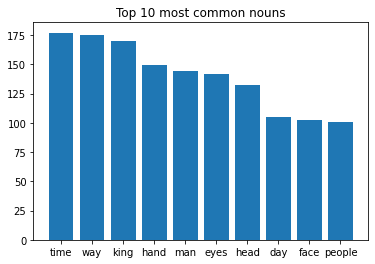

In [ ]:
x=noun_table_10['noun']
y=noun_table_10['noun_count']
plt.bar(x, y)
plt.title('Top 10 most common nouns')
plt.show()

In [ ]:
verb_table_10

,verb,verb_count
121,said,1136
63,know,265
23,had,265
471,think,203
19,have,202
125,looked,191
50,do,186
53,thought,179
15,was,176
28,see,172


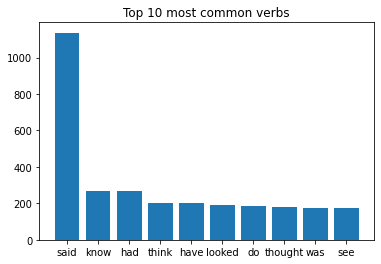

In [ ]:
x=verb_table_10['verb']
y=verb_table_10['verb_count']
plt.bar(x, y)
plt.title('Top 10 most common verbs')
plt.show()

In [ ]:
# from nltk
stop_words = set(stopwords.words('english'))
stop_words.add("I")

In [ ]:
#creating word_token from sentences
print("corpus length =",len(text))
word_tokens = word_tokenize(text)
print("lenght of tokens =",len(word_tokens))
print(word_tokens[0:100])

corpus length = 522550
lenght of tokens = 114620
['The', 'Curse', 'of', 'Kalathan', 'Trina', 'has', 'been', 'thrown', 'into', 'prison', 'for', 'trespassing', 'in', 'the', 'Temple', 'loft', '-', 'not', 'surprising', 'for', 'someone', 'marked', 'and', 'cursed', 'as', 'she', 'is', '.', 'What', 'is', 'astonishing', ',', 'though', ',', 'is', 'that', 'now', 'that', 'her', 'time', 'is', 'up', 'she', 'is', 'not', 'being', 'thrown', 'back', 'onto', 'the', 'streets', ':', 'she', 'is', 'being', 'taken', ',', 'of', 'all', 'places', 'in', 'the', 'whole', 'of', 'Kalathan', ',', 'to', 'the', 'palace', ',', 'home', 'of', 'the', 'six', 'princes', 'she', 'has', 'fangirled', 'over', 'all', 'her', 'life', '.', 'Theo', ',', 'eldest', 'of', 'the', 'princes', ',', 'is', 'convinced', 'that', 'the', 'pilgrimage', 'he', 'has', 'been', 'sent', 'on']


In [ ]:
#removing punctuation, stop words
filtered_tokens = []
for word in word_tokens:
    if word not in punctuation:
        if word not in stop_words:
            filtered_tokens.append(word)

print("length of tokens =",len(filtered_tokens))            
print(filtered_tokens[0:100])

length of tokens = 50956
['The', 'Curse', 'Kalathan', 'Trina', 'thrown', 'prison', 'trespassing', 'Temple', 'loft', 'surprising', 'someone', 'marked', 'cursed', 'What', 'astonishing', 'though', 'time', 'thrown', 'back', 'onto', 'streets', 'taken', 'places', 'whole', 'Kalathan', 'palace', 'home', 'six', 'princes', 'fangirled', 'life', 'Theo', 'eldest', 'princes', 'convinced', 'pilgrimage', 'sent', 'father', 'pointless', 'waste', 'time', 'But', 'shrine', 'holds', 'sinister', 'secret', 'plunges', 'brothers', 'devilclaw', 'Trina', 'adventure', 'take', 'across', 'Kalathan', 'Empire', 'challenge', 'Emperor', 'icy', 'daughter', 'future', 'beloved', 'land', 'Kalathan', 'Still', 'say', 'name', 'country', 'heart', 'swells', 'What', 'makes', 'love', 'land', 'birth', 'How', 'land', 'inanimate', 'land', 'inspire', 'loyalty', 'fierce', 'devotion', 'There', 'time', 'Kalathan', 'tried', 'bury', 'people', 'like', 'time', 'worth', 'less', 'nothing', 'robbed', 'dignity', 'freedom', 'look', 'mark', 'wrist

In [ ]:
word_frequencies = {} 
for word in filtered_tokens:
    if word not in word_frequencies.keys():
        word_frequencies[word] = 1
    else:
        word_frequencies[word] +=1
print(word_frequencies)

{'The': 414, 'Curse': 5, 'Kalathan': 322, 'Trina': 494, 'thrown': 8, 'prison': 40, 'trespassing': 2, 'Temple': 96, 'loft': 5, 'surprising': 5, 'someone': 51, 'marked': 7, 'cursed': 22, 'What': 96, 'astonishing': 1, 'though': 31, 'time': 177, 'back': 253, 'onto': 36, 'streets': 14, 'taken': 44, 'places': 3, 'whole': 16, 'palace': 83, 'home': 67, 'six': 8, 'princes': 57, 'fangirled': 1, 'life': 94, 'Theo': 831, 'eldest': 2, 'convinced': 6, 'pilgrimage': 19, 'sent': 23, 'father': 88, 'pointless': 4, 'waste': 6, 'But': 356, 'shrine': 52, 'holds': 1, 'sinister': 2, 'secret': 8, 'plunges': 1, 'brothers': 75, 'devilclaw': 45, 'adventure': 4, 'take': 85, 'across': 44, 'Empire': 55, 'challenge': 5, 'Emperor': 45, 'icy': 3, 'daughter': 10, 'future': 23, 'beloved': 2, 'land': 30, 'Still': 5, 'say': 95, 'name': 31, 'country': 29, 'heart': 56, 'swells': 1, 'makes': 14, 'love': 31, 'birth': 4, 'How': 49, 'inanimate': 1, 'inspire': 1, 'loyalty': 6, 'fierce': 1, 'devotion': 12, 'There': 160, 'tried': 

In [ ]:
max(word_frequencies.values())

1136

In [ ]:
list_keys = list(word_frequencies.keys())
list_values = list(word_frequencies.values())
#list_keys
#list_values
#converting the dictionary to dataframe
#so that sorting and plotting will become easier
wordcount_table = pd.DataFrame()
wordcount_table['words'] = list_keys
wordcount_table['wordcount'] = list_values
word_count_t = wordcount_table.sort_values(by='wordcount', ascending=False).head(10)
word_count_t

,words,wordcount
414,said,1136
29,Theo,831
425,He,696
221,She,498
3,Trina,494
259,could,426
0,The,414
264,would,384
37,But,356
144,It,331


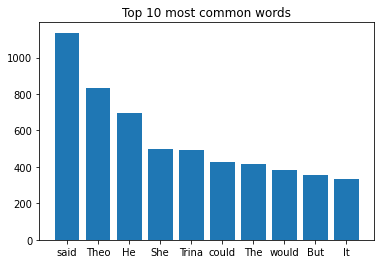

In [ ]:
x=word_count_t['words']
y=word_count_t['wordcount']
plt.bar(x, y)
plt.title('Top 10 most common words')
plt.show()


In [ ]:
bigrams = ngrams(text.split(), 2)

bigram_dict = {}
for item in bigrams:
    #print(item)
    itemText = item[0]+' '+item[1]
    if itemText not in bigram_dict.keys():
        bigram_dict[itemText] = 1
    else:    
        bigram_dict[itemText] +=1 
    
bigram_dict

{'The Curse': 1,
 'Curse of': 2,
 'of Kalathan': 21,
 'Kalathan Trina': 1,
 'Trina has': 3,
 'has been': 20,
 'been thrown': 2,
 'thrown into': 1,
 'into prison': 1,
 'prison for': 3,
 'for trespassing': 1,
 'trespassing in': 1,
 'in the': 415,
 'the Temple': 46,
 'Temple loft': 2,
 'loft -': 1,
 '- not': 1,
 'not surprising': 1,
 'surprising for': 1,
 'for someone': 6,
 'someone marked': 1,
 'marked and': 1,
 'and cursed': 1,
 'cursed as': 1,
 'as she': 82,
 'she is.': 1,
 'is. What': 2,
 'What is': 14,
 'is astonishing,': 1,
 'astonishing, though,': 1,
 'though, is': 1,
 'is that': 4,
 'that now': 2,
 'now that': 15,
 'that her': 11,
 'her time': 1,
 'time is': 3,
 'is up': 2,
 'up she': 3,
 'she is': 11,
 'is not': 21,
 'not being': 3,
 'being thrown': 2,
 'thrown back': 4,
 'back onto': 3,
 'onto the': 16,
 'the streets:': 1,
 'streets: she': 1,
 'is being': 1,
 'being taken,': 1,
 'taken, of': 1,
 'of all': 16,
 'all places': 1,
 'places in': 1,
 'the whole': 4,
 'whole of': 1,
 '

In [ ]:
#converting dictionary to dataframe for sorting and plotting
list_bigram_key = list(bigram_dict.keys()) #converts dictionary keys to list of keys
list_bigram_val = list(bigram_dict.values()) # converts dictionary values to list of values

# creating table for Bigrams
bigram_table = pd.DataFrame()
bigram_table['Bigrams']    = list_bigram_key
bigram_table['Frequency']  = list_bigram_val
bigram_table.sort_values(by='Frequency', ascending=False, inplace=True)
bigram_table_10            = bigram_table.head(10)
bigram_table_10

,Bigrams,Frequency
62,of the,461
12,in the,415
58,to the,308
1136,he had,245
681,on the,221
531,had been,210
107,and the,209
218,at the,205
524,she had,192
741,to be,178


<AxesSubplot:title={'center':'10 most frequent Bigrams'}, xlabel='Bigrams'>

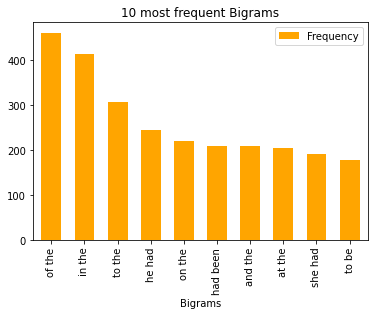

In [ ]:
bigram_table_10.plot('Bigrams','Frequency',kind='bar', width=0.6, color ='orange', title ='10 most frequent Bigrams')

In [ ]:
#creating dicitionary of trigrams with their frequency
trigrams = ngrams(text.split(), 3)

trigram_dict = {}
for item in trigrams:
    #print(item)
    itemText = item[0]+' '+item[1]+' '+item[2]
    if itemText not in trigram_dict.keys():
        trigram_dict[itemText] = 1
    else:    
        trigram_dict[itemText] +=1 
    
trigram_dict

{'The Curse of': 1,
 'Curse of Kalathan': 1,
 'of Kalathan Trina': 1,
 'Kalathan Trina has': 1,
 'Trina has been': 1,
 'has been thrown': 1,
 'been thrown into': 1,
 'thrown into prison': 1,
 'into prison for': 1,
 'prison for trespassing': 1,
 'for trespassing in': 1,
 'trespassing in the': 1,
 'in the Temple': 8,
 'the Temple loft': 2,
 'Temple loft -': 1,
 'loft - not': 1,
 '- not surprising': 1,
 'not surprising for': 1,
 'surprising for someone': 1,
 'for someone marked': 1,
 'someone marked and': 1,
 'marked and cursed': 1,
 'and cursed as': 1,
 'cursed as she': 1,
 'as she is.': 1,
 'she is. What': 1,
 'is. What is': 1,
 'What is astonishing,': 1,
 'is astonishing, though,': 1,
 'astonishing, though, is': 1,
 'though, is that': 1,
 'is that now': 2,
 'that now that': 1,
 'now that her': 1,
 'that her time': 1,
 'her time is': 1,
 'time is up': 1,
 'is up she': 1,
 'up she is': 1,
 'she is not': 1,
 'is not being': 1,
 'not being thrown': 1,
 'being thrown back': 2,
 'thrown back

In [ ]:
list_trigram_key = list(trigram_dict.keys()) #converts dictionary keys to list of keys
list_trigram_val = list(trigram_dict.values()) # converts dictionary values to list of values

# creating table for noun words frequency
trigram_table = pd.DataFrame()
trigram_table['Trigrams']    = list_trigram_key
trigram_table['Frequency']  = list_trigram_val
trigram_table.sort_values(by='Frequency', ascending=False, inplace=True)
trigram_table_10            = trigram_table.head(10)
trigram_table_10

,Trigrams,Frequency
589,one of the,48
2574,out of the,37
4712,he had been,35
603,she had been,32
4604,as if he,30
236,there was a,29
1340,in front of,28
2009,as if she,27
9947,back to the,27
12539,I want to,27


<AxesSubplot:title={'center':'10 most frequent Trigrams'}, xlabel='Trigrams'>

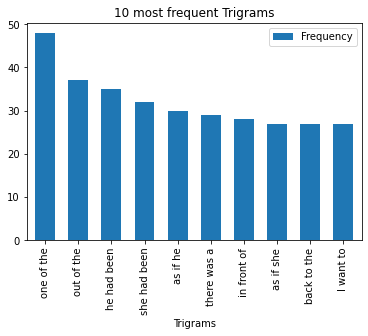

In [ ]:

trigram_table_10.plot('Trigrams','Frequency', kind='bar', width=0.6, title ='10 most frequent Trigrams')

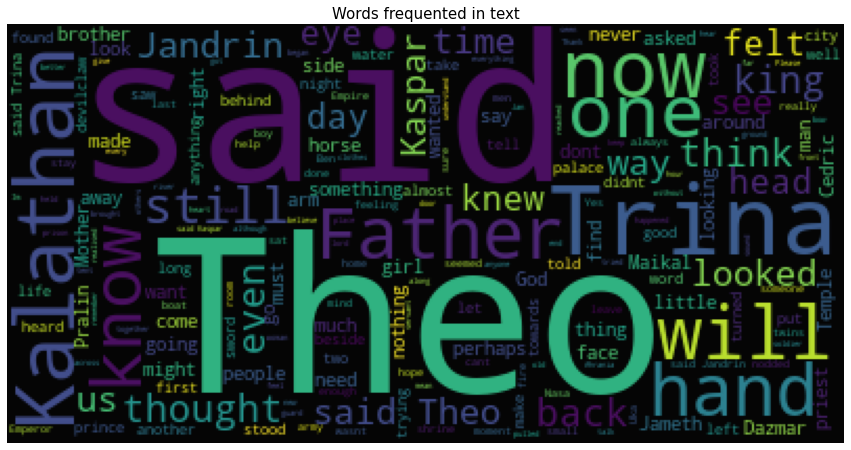

In [ ]:
stopwords = set(STOPWORDS)
wordcloud = WordCloud(
                        background_color='black',
                        stopwords=stopwords,
                        max_words=200, 
                        random_state=42).generate(str(text))

plt.figure(figsize=(15,10))
plt.axis("off")
plt.title("Words frequented in text", fontsize=15)
plt.imshow(wordcloud.recolor(colormap= 'viridis' , random_state=42), alpha=0.98)
plt.show()

# Model Building - Extractive Summerizer


## Word frequency - Spacy

In [ ]:
nlp = spacy.load('en_core_web_sm')

In [ ]:
print("length of corpus =",len(text))
#passing entire corpus(string)
doc = nlp(text)
print("length of doc =",len(doc))
doc

length of corpus = 522550
length of doc = 115787


 The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life. Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. Kalathan. Still, when I say the name of my country my heart swells. What is it, that makes me love the land of my birth? How can a land, an inanimate land, inspire such loyalty and fierce devotion in

In [ ]:
#print tokens from the doc
word_tokens = [tokens.text for tokens in doc]
print("length of tokens", len(word_tokens))
print(word_tokens)

length of tokens 115787
[' ', 'The', 'Curse', 'of', 'Kalathan', 'Trina', 'has', 'been', 'thrown', 'into', 'prison', 'for', 'trespassing', 'in', 'the', 'Temple', 'loft', '-', 'not', 'surprising', 'for', 'someone', 'marked', 'and', 'cursed', 'as', 'she', 'is', '.', 'What', 'is', 'astonishing', ',', 'though', ',', 'is', 'that', 'now', 'that', 'her', 'time', 'is', 'up', 'she', 'is', 'not', 'being', 'thrown', 'back', 'onto', 'the', 'streets', ':', 'she', 'is', 'being', 'taken', ',', 'of', 'all', 'places', 'in', 'the', 'whole', 'of', 'Kalathan', ',', 'to', 'the', 'palace', ',', 'home', 'of', 'the', 'six', 'princes', 'she', 'has', 'fangirled', 'over', 'all', 'her', 'life', '.', 'Theo', ',', 'eldest', 'of', 'the', 'princes', ',', 'is', 'convinced', 'that', 'the', 'pilgrimage', 'he', 'has', 'been', 'sent', 'on', 'by', 'his', 'father', 'is', 'a', 'pointless', 'waste', 'of', 'time', '.', 'But', 'the', 'shrine', 'holds', 'a', 'sinister', 'secret', 'that', 'plunges', 'him', ',', 'his', 'brothers', 

In [ ]:
spacy_stopwords = list(STOP_WORDS)
print(spacy_stopwords)

['had', 'yourself', 'all', 'beforehand', 'anyone', 'than', 'herself', 'somewhere', 'around', 'moreover', '‘m', 'more', '’m', 'three', 'such', 'using', 'hence', 'our', 'then', 'empty', 'and', 'call', 'whereafter', 'hereby', 'another', 'during', 'them', 'whose', 'thereafter', 'why', 'should', 'how', 'where', 'afterwards', '‘ve', 'from', "'re", 'whereupon', 'wherein', 'everyone', 'too', 'you', 'indeed', 'least', 'your', 'ca', 'latterly', "'ll", 'through', 'go', 'keep', 'among', 'per', 'except', 'always', 'have', 'herein', 'everywhere', 'thereby', 'her', 'really', 'due', "'d", 'hereupon', 'up', 'or', 'nine', 'fifty', 'ourselves', 'whereas', 'nor', 'seems', 'as', 'together', 'be', 'whither', 'throughout', 'besides', 'nevertheless', 'over', 'whether', 'an', 'rather', 'twenty', 'thru', 'often', 'below', 'eight', 'whoever', 'nothing', 'whom', 'say', 'yours', 'against', 'very', 'he', 'whence', 'alone', 'cannot', 'himself', 'see', "n't", 'unless', 'was', 'were', 'that', 'quite', 'seeming', 'abou

In [ ]:
punctuation = punctuation + " " + "“" + "”"

In [ ]:
#removing punctuation and stopwords
#creates word frequency dictionary with words(keys) thier frequency(values)
word_frequencies = {} 
for word in word_tokens:
    if word not in punctuation:
        if word not in spacy_stopwords:
            if word not in word_frequencies.keys():
                word_frequencies[word] = 1
            else:
                word_frequencies[word] +=1

print(word_frequencies)

{'The': 414, 'Curse': 5, 'Kalathan': 322, 'Trina': 494, 'thrown': 8, 'prison': 40, 'trespassing': 2, 'Temple': 96, 'loft': 5, 'surprising': 5, 'marked': 7, 'cursed': 22, 'What': 99, 'astonishing': 1, 'time': 177, 'streets': 14, 'taken': 44, 'places': 3, 'palace': 83, 'home': 67, 'princes': 57, 'fangirled': 1, 'life': 95, 'Theo': 831, 'eldest': 2, 'convinced': 6, 'pilgrimage': 19, 'sent': 23, 'father': 88, 'pointless': 4, 'waste': 6, 'But': 356, 'shrine': 52, 'holds': 1, 'sinister': 2, 'secret': 8, 'plunges': 1, 'brothers': 75, 'devilclaw': 45, 'adventure': 4, 'Empire': 55, 'challenge': 5, 'Emperor': 45, 'icy': 3, 'daughter': 10, 'future': 23, 'beloved': 2, 'land': 30, 'Still': 5, 'I': 1255, 'country': 29, 'heart': 57, 'swells': 1, 'makes': 14, 'love': 31, 'birth': 4, 'How': 49, 'inanimate': 1, 'inspire': 1, 'loyalty': 6, 'fierce': 1, 'devotion': 12, 'There': 174, 'tried': 43, 'bury': 1, 'people': 101, 'like': 247, 'worth': 18, 'robbed': 2, 'dignity': 2, 'freedom': 8, 'look': 88, 'mark'

In [ ]:
max_frequency = max(word_frequencies.values())
max_frequency

1255

In [ ]:
for word in word_frequencies.keys():
    word_frequencies[word] = word_frequencies[word]/max_frequency
    
print(word_frequencies)

{'The': 0.3298804780876494, 'Curse': 0.00398406374501992, 'Kalathan': 0.25657370517928285, 'Trina': 0.39362549800796814, 'thrown': 0.006374501992031873, 'prison': 0.03187250996015936, 'trespassing': 0.0015936254980079682, 'Temple': 0.07649402390438247, 'loft': 0.00398406374501992, 'surprising': 0.00398406374501992, 'marked': 0.005577689243027889, 'cursed': 0.01752988047808765, 'What': 0.07888446215139443, 'astonishing': 0.0007968127490039841, 'time': 0.14103585657370518, 'streets': 0.011155378486055778, 'taken': 0.0350597609561753, 'places': 0.002390438247011952, 'palace': 0.06613545816733067, 'home': 0.05338645418326693, 'princes': 0.04541832669322709, 'fangirled': 0.0007968127490039841, 'life': 0.07569721115537849, 'Theo': 0.6621513944223107, 'eldest': 0.0015936254980079682, 'convinced': 0.004780876494023904, 'pilgrimage': 0.015139442231075698, 'sent': 0.018326693227091632, 'father': 0.0701195219123506, 'pointless': 0.0031872509960159364, 'waste': 0.004780876494023904, 'But': 0.28366

In [ ]:
sentence_tokens = [sent for sent in doc.sents]
print("length of sentence tokens =",len(sentence_tokens),"\n")
print(sentence_tokens)

length of sentence tokens = 7934 

[ The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is., What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life., Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time., But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land., Kalathan., Still, when I say the name of my country my heart swells., What is it, that makes me love the land of my birth?, How can a land, an inanimate land, 

In [ ]:
sentence_scores = {}

for sent in sentence_tokens:
        for word in sent: # for each word in sentence
            if word.text.lower() in word_frequencies.keys(): # if word exists in word frequency dict
                if sent not in sentence_scores.keys():
                    sentence_scores[sent] = word_frequencies[word.text.lower()]#freq. of word from word_freq dict assig to sent_score dict
                else:
                    sentence_scores[sent] += word_frequencies[word.text.lower()]

In [ ]:
sentence_scores

{ The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is.: 0.08525896414342629,
 What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life.: 0.43824701195219123,
 Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time.: 0.3043824701195219,
 But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land.: 0.20876494023904382,
 Still, when I say the name of my country my heart swells.: 0.0693227091633466,
 What is it, that makes me l

In [ ]:
#30% of the sentences from the entire corpus will be selected
# ie 30% of 7934 sentences = 2380 sentences
select_length = int(len(sentence_tokens)*0.15)
select_length

1190

In [ ]:
from heapq import nlargest

In [ ]:
summary = nlargest(select_length,sentence_scores,key=sentence_scores.get)
summary

[You said you werent going to do that anymore, she said, trying in vain to control her voice.,
 The song said she didnt care what people thought, that she didnt believe in luck.,
 I picked her a posy of flowers And she took them, said she didnt care She didnt care what the people would say She never believed in luck,
 But my lord, said the taller girl, we are She paused, and he looked at her, amazed that she would consider for one moment not doing as he had said.,
 Sabine dismissed her questions and said very little else, and the other servants who brought food and bathwater and helped her to scrub off the months of dirt said nothing at all.,
 She said it was a womans matter, he said, looking so completely mortified that Theo almost felt sorry for him.,
 Let one of us take a turn, said Jan. Im all right, he said, leaning on the spade.,
 If we were at home I would go to the Temple and pray for you, Jandrin said, his voice faltering a little as he said it.,
 She smiled at him, a smile th

In [ ]:
summary_spacy_wordfrequency = ' '.join([str(elem) for elem in summary])
print("Summary :\n",summary_spacy_wordfrequency)

Summary :
 You said you werent going to do that anymore, she said, trying in vain to control her voice. The song said she didnt care what people thought, that she didnt believe in luck. I picked her a posy of flowers And she took them, said she didnt care She didnt care what the people would say She never believed in luck But my lord, said the taller girl, we are She paused, and he looked at her, amazed that she would consider for one moment not doing as he had said. Sabine dismissed her questions and said very little else, and the other servants who brought food and bathwater and helped her to scrub off the months of dirt said nothing at all. She said it was a womans matter, he said, looking so completely mortified that Theo almost felt sorry for him. Let one of us take a turn, said Jan. Im all right, he said, leaning on the spade. If we were at home I would go to the Temple and pray for you, Jandrin said, his voice faltering a little as he said it. She smiled at him, a smile that sai

# Using NLTK

In [ ]:
sentences  = sent_tokenize(text)
print(sentences)
total_documents = len(sentences)
total_documents

[' The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is.', 'What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life.', 'Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time.', 'But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land.', 'Kalathan.', 'Still, when I say the name of my country my heart swells.', 'What is it, that makes me love the land of my birth?', 'How can a land, an inanimate land, inspire such loyalty

7942

In [ ]:
from nltk.corpus import stopwords
def create_frequency_matrix(sentences):
    frequency_matrix = {}
    stop_words = set(stopwords.words('english'))
    ps = PorterStemmer()
    
    for sent in sentences:
        #print(sent,"\n")
        freq_table = {}
        words = word_tokenize(sent)
        #print(words,"\n")
        for word in words:
            word = word.lower()
            word = ps.stem(word)
            if word in stop_words:
                continue
            
            #print(word)
            if word in freq_table:
                freq_table[word] += 1
            else:
                freq_table[word] = 1
                
        frequency_matrix[sent[:15]] = freq_table
        
    return frequency_matrix


In [ ]:
freq_matrix = create_frequency_matrix(sentences)
print(freq_matrix)

{' The Curse of K': {'curs': 2, 'kalathan': 1, 'trina': 1, 'ha': 1, 'thrown': 1, 'prison': 1, 'trespass': 1, 'templ': 1, 'loft': 1, '-': 1, 'surpris': 1, 'someon': 1, 'mark': 1, '.': 1}, 'What is astonis': {'astonish': 1, ',': 5, 'though': 1, 'time': 1, 'thrown': 1, 'back': 1, 'onto': 1, 'street': 1, ':': 1, 'taken': 1, 'place': 1, 'whole': 1, 'kalathan': 1, 'palac': 1, 'home': 1, 'six': 1, 'princ': 1, 'ha': 1, 'fangirl': 1, 'life': 1, '.': 1}, 'Theo, eldest of': {'theo': 1, ',': 2, 'eldest': 1, 'princ': 1, 'convinc': 1, 'pilgrimag': 1, 'ha': 1, 'sent': 1, 'hi': 1, 'father': 1, 'pointless': 1, 'wast': 1, 'time': 1, '.': 1}, 'But the shrine ': {'shrine': 1, 'hold': 1, 'sinist': 1, 'secret': 1, 'plung': 1, ',': 2, 'hi': 2, 'brother': 1, 'devilclaw': 1, 'trina': 1, 'adventur': 1, 'take': 1, 'across': 1, 'kalathan': 1, 'empir': 1, 'challeng': 1, 'emperor': 1, 'ici': 1, 'daughter': 1, 'futur': 1, 'belov': 1, 'land': 1, '.': 1}, 'Kalathan.': {'kalathan': 1, '.': 1}, 'Still, when I s': {'stil

In [ ]:
#calculating term frequency
#Here, the document is a sentence, the term is a word in sentence
def create_tf_matrix(freq_matrix):
    tf_matrix = {}
    
    for sent,f_table in freq_matrix.items():
        #print(f_table)
        tf_table = {}
        count_words_sentence = len(f_table)
        #print(count_words_sentence)
        for word, count in f_table.items():
            tf_table[word] = count/count_words_sentence

        tf_matrix[sent] = tf_table
            
    return tf_matrix 

#calculate the term frequency and generate a matrix
tf_matrix = create_tf_matrix(freq_matrix)
print(tf_matrix)

{' The Curse of K': {'curs': 0.14285714285714285, 'kalathan': 0.07142857142857142, 'trina': 0.07142857142857142, 'ha': 0.07142857142857142, 'thrown': 0.07142857142857142, 'prison': 0.07142857142857142, 'trespass': 0.07142857142857142, 'templ': 0.07142857142857142, 'loft': 0.07142857142857142, '-': 0.07142857142857142, 'surpris': 0.07142857142857142, 'someon': 0.07142857142857142, 'mark': 0.07142857142857142, '.': 0.07142857142857142}, 'What is astonis': {'astonish': 0.047619047619047616, ',': 0.23809523809523808, 'though': 0.047619047619047616, 'time': 0.047619047619047616, 'thrown': 0.047619047619047616, 'back': 0.047619047619047616, 'onto': 0.047619047619047616, 'street': 0.047619047619047616, ':': 0.047619047619047616, 'taken': 0.047619047619047616, 'place': 0.047619047619047616, 'whole': 0.047619047619047616, 'kalathan': 0.047619047619047616, 'palac': 0.047619047619047616, 'home': 0.047619047619047616, 'six': 0.047619047619047616, 'princ': 0.047619047619047616, 'ha': 0.047619047619

In [ ]:
#calculating how many sentences contains a word
def create_documents_per_words(freq_matrix):
    word_per_doc_table = {}
    
    for sent, f_table in freq_matrix.items():
        #print(sent)
        #print(f_table)
        for word, count in f_table.items():
            if word in word_per_doc_table:
                #print(word)
                word_per_doc_table[word] +=1
            else:
                word_per_doc_table[word] = 1
                
    return word_per_doc_table

#creating table for documents per words
count_doc_per_words  = create_documents_per_words(freq_matrix)
print(count_doc_per_words)

{'curs': 40, 'kalathan': 317, 'trina': 464, 'ha': 105, 'thrown': 8, 'prison': 50, 'trespass': 2, 'templ': 91, 'loft': 5, '-': 1, 'surpris': 39, 'someon': 53, 'mark': 34, '.': 6241, 'astonish': 1, ',': 4026, 'though': 29, 'time': 170, 'back': 218, 'onto': 33, 'street': 25, ':': 25, 'taken': 40, 'place': 56, 'whole': 15, 'palac': 80, 'home': 67, 'six': 8, 'princ': 74, 'fangirl': 1, 'life': 89, 'theo': 737, 'eldest': 2, 'convinc': 15, 'pilgrimag': 21, 'sent': 22, 'hi': 937, 'father': 242, 'pointless': 4, 'wast': 8, 'shrine': 54, 'hold': 51, 'sinist': 2, 'secret': 8, 'plung': 1, 'brother': 127, 'devilclaw': 64, 'adventur': 4, 'take': 124, 'across': 41, 'empir': 60, 'challeng': 6, 'emperor': 57, 'ici': 3, 'daughter': 13, 'futur': 22, 'belov': 2, 'land': 38, 'still': 201, 'say': 122, 'name': 31, 'countri': 32, 'heart': 46, 'swell': 3, 'make': 129, 'love': 54, 'birth': 5, '?': 623, 'inanim': 1, 'inspir': 3, 'loyalti': 6, 'fierc': 4, 'devot': 12, 'wa': 1273, 'tri': 120, 'buri': 6, 'peopl': 106

In [ ]:
#calculating IDF for each word in a sentence
def create_idf_matrix(freq_matrix, count_doc_per_words, total_documents):
    idf_matrix = {}
    
    for sent, f_table in freq_matrix.items():
        idf_table = {}
        #print(sent)

        for word in f_table.keys():
            idf_table[word] = math.log10(total_documents / float(count_doc_per_words[word]))

        idf_matrix[sent] = idf_table

    return idf_matrix

# calculate IDF and generate a matrix
idf_matrix = create_idf_matrix(freq_matrix, count_doc_per_words, total_documents)
print(idf_matrix)

{' The Curse of K': {'curs': 2.297869891399902, 'kalathan': 1.3988706205101127, 'trina': 1.2334119021729832, 'ha': 1.878740583657926, 'thrown': 2.9968398957359206, 'prison': 2.200959878391845, 'trespass': 3.598899887063883, 'templ': 1.9408884904067705, 'loft': 3.2009598783918456, '-': 3.8999298827278643, 'surpris': 2.308865275701365, 'someon': 2.175654013127075, 'mark': 2.368450965685609, '.': 0.10467570014698134}, 'What is astonis': {'astonish': 3.8999298827278643, ',': 0.2950561121752284, 'though': 2.4375318848289083, 'time': 1.6694809613495902, 'thrown': 2.9968398957359206, 'back': 1.5614733891232593, 'onto': 2.381415942849977, 'street': 2.5019898740558264, ':': 2.5019898740558264, 'taken': 2.297869891399902, 'place': 2.1517418557216637, 'whole': 2.723838623672183, 'kalathan': 1.3988706205101127, 'palac': 1.9968398957359206, 'home': 2.073855080027038, 'six': 2.9968398957359206, 'princ': 2.030698162996888, 'ha': 1.878740583657926, 'fangirl': 3.8999298827278643, 'life': 1.950539876082

In [ ]:
#calculating TF-IDF (i.e TF*IDF)
def create_tf_idf_matrix(tf_matrix, idf_matrix):
    tf_idf_matrix = {}
    for (sent1, f_table1), (sent2, f_table2) in zip(tf_matrix.items(), idf_matrix.items()):

        tf_idf_table = {}

        for (word1, value1), (word2, value2) in zip(f_table1.items(),f_table2.items()):  # here, keys are the same in both the table
            tf_idf_table[word1] = float(value1 * value2)

        tf_idf_matrix[sent1] = tf_idf_table

    return tf_idf_matrix

# Calculate TF-IDF and generate a matrix
tf_idf_matrix = create_tf_idf_matrix(tf_matrix, idf_matrix)
print(tf_idf_matrix)

{' The Curse of K': {'curs': 0.3282671273428431, 'kalathan': 0.09991933003643662, 'trina': 0.08810085015521309, 'ha': 0.13419575597556613, 'thrown': 0.21405999255256575, 'prison': 0.1572114198851318, 'trespass': 0.2570642776474202, 'templ': 0.13863489217191216, 'loft': 0.22863999131370324, '-': 0.27856642019484745, 'surpris': 0.1649189482643832, 'someon': 0.15540385808050536, 'mark': 0.1691750689775435, '.': 0.007476835724784381}, 'What is astonis': {'astonish': 0.18571094679656497, ',': 0.07025145527981629, 'though': 0.11607294689661467, 'time': 0.07949909339759953, 'thrown': 0.1427066617017105, 'back': 0.07435587567253615, 'onto': 0.11340075918333223, 'street': 0.11914237495503935, ':': 0.11914237495503935, 'taken': 0.1094223757809477, 'place': 0.10246389789150778, 'whole': 0.1297066011272468, 'kalathan': 0.06661288669095775, 'palac': 0.09508761408266288, 'home': 0.09875500381081133, 'six': 0.1427066617017105, 'princ': 0.09669991252366134, 'ha': 0.08946383731704409, 'fangirl': 0.1857

In [ ]:
#scoring sentences
def score_sentences(tf_idf_matrix) -> dict:
    sentenceValue = {}

    for sent, f_table in tf_idf_matrix.items():
        total_score_per_sentence = 0

        count_words_in_sentence = len(f_table)
        for word, score in f_table.items():
            total_score_per_sentence += score

        sentenceValue[sent] = total_score_per_sentence / count_words_in_sentence

    return sentenceValue

#score the sentences
sentence_scores = score_sentences(tf_idf_matrix)
print(sentence_scores)

{' The Curse of K': 0.17297391202306114, 'What is astonis': 0.1064180778549176, 'Theo, eldest of': 0.1403221475700493, 'But the shrine ': 0.1009326607498419, 'Kalathan.': 0.3758865801642735, 'Still, when I s': 0.22302131971935535, 'What is it, tha': 0.3021800113355648, 'How can a land,': 0.3577965984969014, 'There was a tim': 0.1463519732346264, 'I only have to ': 0.2882581887102269, 'But then, there': 0.2059992553770978, 'I chose Kalatha': 0.5064864625967446, 'I remember the ': 0.1567849256313181, 'I see the great': 0.11419126442911451, 'I picture the d': 0.17270809067059642, 'I see the peopl': 0.11789539808321403, 'It is a differe': 0.06947460409550077, 'It is different': 0.15571919141108326, 'It is home, the': 0.21343607134876877, 'It is life, sus': 0.31174144620930355, 'It is purpose, ': 0.22957664649541434, 'Kalathan is a s': 0.20418018570860613, 'I once thought ': 0.13570958194368526, 'When the door o': 0.15706530294849366, 'It had been mon': 0.6705965720352315, 'She did know th'

In [ ]:
#calculating threshold = average sentece score
def find_average_score(sentenceValue) -> int:
    
    sumValues = 0
    for entry in sentenceValue:
        sumValues += sentenceValue[entry]

    # Average value of a sentence from original summary_text
    average = (sumValues / len(sentenceValue))

    return average

#Find the threshold
threshold = find_average_score(sentence_scores)
print(threshold)

0.30513285081622626


In [ ]:
#select a sentence if the sentence score is greater than threshold
def generate_summary(sentences, sentenceValue, threshold):
    sentence_count = 0
    summary = ''

    for sentence in sentences:
        #print(sentence)
       # print(sentenceValue)
        #print(threshold)
        if sentence[:15] in sentenceValue and sentenceValue[sentence[:15]] >= (threshold):
        #if sentenceValue[sentence[:15]] >= (threshold):
            #print("inside if")
            #print(sentenceValue[sentence[:15]])
            #print(sentenceValue[sentence],"\n")
            summary += " " + sentence
            sentence_count += 1

    #print("==============",summary)
    return summary

In [ ]:
summary_nltk_tfidf = generate_summary(sentences, sentence_scores, 1.5 * threshold)
print("summary:\n",summary_nltk_tfidf)

summary:
  I chose Kalathan. It had been months, she knew, since the soldiers had caught her sleeping in one of the lofts in the Temple and taken her away, but exactly how long she had been locked up she did not know. Alone. Where are you taking me? Are you sure? We need to prove our devotion. All of us? When? When do we leave? Can I watch the sacrifice? What will it be a lamb? A bull? So many questions! We are in more trouble than you know. "More trouble? What do you mean, Father on the border?" We need it desperately." It had been three months. The Devils claw! But that had all been ten years ago. Was it ivory? The Devils claw. She hadnt been released. The prisons were full of them. But it couldnt be right. That is odd. A coincidence? And there are other examples. Everyone knows that. We can trust them. I found an example today. They did? She seemed excited. I dont understand. Or Amrak. Shihazar? he asked. And that was treason. From Ahrania. Do you think we are leaving now? she whisp

# TfidfVectorizer - Sklearn

In [ ]:
sentences  = sent_tokenize(text)
print(sentences)
total_documents = len(sentences)
total_documents


[' The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is.', 'What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life.', 'Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time.', 'But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land.', 'Kalathan.', 'Still, when I say the name of my country my heart swells.', 'What is it, that makes me love the land of my birth?', 'How can a land, an inanimate land, inspire such loyalty

7942

In [ ]:
ps = PorterStemmer()
def stemming_tokenizer(str_input):
    words = re.sub(r"[^A-Za-z0-9\-]", " ", str_input).lower().split()
    words = [ps.stem(word) for word in words]
    return words

In [ ]:
vectorizer = TfidfVectorizer(analyzer='word', stop_words = 'english', tokenizer = stemming_tokenizer, ngram_range=(2,2))
tfidf = vectorizer.fit_transform(sentences)
tfidf.toarray()

D:\user\sandeep\envs\virtual\lib\site-packages\sklearn\feature_extraction\text.py:396: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['abov', 'afterward', 'alon', 'alreadi', 'alway', 'ani', 'anoth', 'anyon', 'anyth', 'anywher', 'becam', 'becaus', 'becom', 'befor', 'besid', 'cri', 'describ', 'dure', 'els', 'elsewher', 'empti', 'everi', 'everyon', 'everyth', 'everywher', 'fifti', 'formerli', 'forti', 'ha', 'henc', 'hereaft', 'herebi', 'hi', 'howev', 'hundr', 'inde', 'latterli', 'mani', 'meanwhil', 'moreov', 'mostli', 'nobodi', 'noon', 'noth', 'nowher', 'onc', 'onli', 'otherwis', 'ourselv', 'perhap', 'pleas', 'seriou', 'sever', 'sinc', 'sincer', 'sixti', 'someon', 'someth', 'sometim', 'somewher', 'themselv', 'thenc', 'thereaft', 'therebi', 'therefor', 'thi', 'thu', 'togeth', 'twelv', 'twenti', 'veri', 'wa', 'whatev', 'whenc', 'whenev', 'wherea', 'whereaft', 'wherebi', 'wherev', 'whi', 'yourselv'] not in stop_words.
  w

array([[0.28400311, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
df = pd.DataFrame(tfidf.toarray(), columns= vectorizer.get_feature_names())
df

D:\user\sandeep\envs\virtual\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,- surpris,aback hi,aback moment,abandon barn,abandon famili,abandon kalathan,abandon religion,abandon templ,abbrevi stori,abdic favour,...,younger theo,younger wa,yourselv readi,youth leant,youv got,youv guess,zone enslav,zone includ,zone noth,zone said
0,0.284003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7937,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7938,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7939,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7940,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df['sentence'] = sentences
df.head(5)

,- surpris,aback hi,aback moment,abandon barn,abandon famili,abandon kalathan,abandon religion,abandon templ,abbrevi stori,abdic favour,...,younger wa,yourselv readi,youth leant,youv got,youv guess,zone enslav,zone includ,zone noth,zone said,sentence
0,0.284003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,The Curse of Kalathan Trina has been thrown i...
1,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"What is astonishing, though, is that now that ..."
2,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"Theo, eldest of the princes, is convinced that..."
3,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,But the shrine holds a sinister secret that pl...
4,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Kalathan.


In [ ]:
df['sentence score'] = df.sum(axis=1)
df['sentence score']

C:\Users\sande\AppData\Local\Temp\ipykernel_16680\3813591283.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['sentence score'] = df.sum(axis=1)


0       3.603650
1       3.463469
2       3.300632
3       4.341678
4       0.000000
          ...   
7937    2.235721
7938    1.731673
7939    3.162004
7940    3.313859
7941    4.471749
Name: sentence score, Length: 7942, dtype: float64

In [ ]:
df.sort_values(by='sentence score', ascending=False, inplace=True)
df[['sentence','sentence score']]

,sentence,sentence score
6673,There was a blanket around Theos shoulders as ...,5.914312
2225,"Shes a lovely one, my Nina, My Nina girl of wh...",5.878345
173,She was clean; for the first time in months sh...,5.773094
5861,"And now that they were in the city, she knew w...",5.741108
16,It is a different devotion to the one I have f...,5.564718
...,...,...
4609,I can help you.,0.000000
6478,What is that?,0.000000
1799,Whats wrong with her?,0.000000
6474,Clean him up.,0.000000


In [ ]:
summary_length  = int(len(sentences)*15/100)
df_tfidf_topscore = df[['sentence','sentence score']].head(summary_length)
print(df_tfidf_topscore.shape)
df_tfidf_topscore

(1191, 2)


,sentence,sentence score
6673,There was a blanket around Theos shoulders as ...,5.914312
2225,"Shes a lovely one, my Nina, My Nina girl of wh...",5.878345
173,She was clean; for the first time in months sh...,5.773094
5861,"And now that they were in the city, she knew w...",5.741108
16,It is a different devotion to the one I have f...,5.564718
...,...,...
2397,"She knew it was odd, to have asked Theo, but t...",2.978691
673,He had never in his life considered for a mome...,2.978253
4191,"Forgive me, Trina, he said, trying to exert hi...",2.978003
1437,"Theo was angry, she realised, furious that the...",2.977147


In [ ]:
df_tfidf_topscore = df_tfidf_topscore.reset_index(drop=True)
print(len(df_tfidf_topscore))
df_tfidf_topscore

1191


,sentence,sentence score
0,There was a blanket around Theos shoulders as ...,5.914312
1,"Shes a lovely one, my Nina, My Nina girl of wh...",5.878345
2,She was clean; for the first time in months sh...,5.773094
3,"And now that they were in the city, she knew w...",5.741108
4,It is a different devotion to the one I have f...,5.564718
...,...,...
1186,"She knew it was odd, to have asked Theo, but t...",2.978691
1187,He had never in his life considered for a mome...,2.978253
1188,"Forgive me, Trina, he said, trying to exert hi...",2.978003
1189,"Theo was angry, she realised, furious that the...",2.977147


In [ ]:
summary_tfidf = ''
for i in range(len(df_tfidf_topscore)):
    summary_tfidf += df_tfidf_topscore['sentence'][i]
    
summary_tfidf

'There was a blanket around Theos shoulders as he was ushered into a comfortable tent, with carpets beneath his filthy boots still crusted with dirt and blood, a cup of steaming tea in his shaking hands, a bowl of warm water to wash, and then, like something out of a dream, there was Father, embracing him even in his bloody clothes, weeping.Shes a lovely one, my Nina, My Nina girl of whom I sing Too lovely for the likes of me though, For shes stolen the heart of a king How I miss the sweetness of hours How I miss the gold of her hair I picked her a posy of flowers And she took them, said she didnt care She didnt care what the people would say She never believed in luck anyway But its all just a dream He will make her a queen She has stolen the heart of a king She has stolen the heart of a king Theres no fighting for love when your rivals your lord Just to think of her beauty means the wrath of his sword She has stolen the heart of a king!She was clean; for the first time in months she 

## Automatic Summarizers

## Using Sumy

In [ ]:
language = "english"
sentence_count = 1191
 
parser = PlaintextParser(text, Tokenizer(language))

In [ ]:
summarizer = LexRankSummarizer(Stemmer(language))
summarizer.stop_words = get_stop_words(language)
#Summarize the document with 2 sentences
summary = summarizer(parser.document, sentence_count) 
    
summary_pre_LexRankSummarizer = ' '.join([str(sentence) for sentence in summary])
summary_pre_LexRankSummarizer

'Kalathan. But then, there was a time when Kalathan needed me, a time when I had a choice: save yourself or save your land. It is different to the love and gratefulness I have to God who has made everything what it is, even Kalathan itself Kalathan in a way is all of my loves, together. It is home, the source and the beginning of the people I love, it is Gods beautiful creation. I once thought I was sacrificing everything for Kalathan, but in the end there was mercy; Kalathan has given me more, far more than I gave up. It had been months, she knew, since the soldiers had caught her sleeping in one of the lofts in the Temple and taken her away, but exactly how long she had been locked up she did not know. She had been so sure, months ago, that she could live through it, that she had survived hard things before, and she would do it again. She had been staring up at the window high in the wall, trying to remember what it felt like to be clean and warm. She longed to be free, but she knew 

In [ ]:
from sumy.summarizers.luhn import LuhnSummarizer
summarizer_1 = LuhnSummarizer(Stemmer(language))
summarizer_1.stop_words = get_stop_words(language)
summary_1 = summarizer_1(parser.document, sentence_count)

summary_pre_LuhnSummarizer = ' '.join([str(sentence) for sentence in summary_1])
summary_pre_LuhnSummarizer

'The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. How can a land, an inanimate land, inspire such loyalty and fierce devotion in me? I see the great river, born high in the Northern peaks, running determinedly past the city towards the great lake in the south and remember how its water was almost the end of me. I see the people, tasselled and embroidered scarves adorning their weathered faces, wrapping themselves in furs against the bitter winter winds, mirrored beads tinkling from the doorways of houses and tents in a summer breeze. It is a different devotion to the one I have felt as I have gazed at my children after they were put into my arms for the first time, different to the love I have felt for my dear husband as we have walked through life together, as I have watched the hair at his temples turn to grey, as we clasp hands before each meal, our fingers no longer smooth and strong

In [ ]:
from sumy.summarizers.lsa import LsaSummarizer
summarizer_2 = LsaSummarizer(Stemmer(language))
summarizer_2.stop_words = get_stop_words(language)
summary_2 = summarizer_2(parser.document, sentence_count)

summary_pre_LsaSummarizer = ' '.join([str(sentence) for sentence in summary_2])
summary_pre_LsaSummarizer

D:\user\sandeep\envs\virtual\lib\site-packages\sumy\summarizers\lsa.py:76: UserWarning: Number of words (3808) is lower than number of sentences (7942). LSA algorithm may not work properly.
  warn(message % (words_count, sentences_count))


'Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. I picture the desolate mountains in the north, the thirst that almost overcame us, and imagine the vast arid desert beyond them. I see the people, tasselled and embroidered scarves adorning their weathered faces, wrapping themselves in furs against the bitter winter winds, mirrored beads tinkling from the doorways of houses and tents in a summer breeze. It is a different devotion to the one I have felt as I have gazed at my children after they were put into my arms for the first time, different to the love I have felt for my dear husband as we have walked through life together, as I ha

In [ ]:
from sumy.summarizers.text_rank import TextRankSummarizer
summarizer_3 = TextRankSummarizer(Stemmer(language))
summarizer_3.stop_words = get_stop_words(language)
summary_3 = summarizer_3(parser.document, sentence_count)

summary_pre_TextRankSummarizer = ' '.join([str(sentence) for sentence in summary_3])
summary_pre_TextRankSummarizer

'The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life. Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. There was a time when Kalathan tried to bury people like me, a time when I was worth less than nothing and was robbed of both my dignity and my freedom. But then, there was a time when Kalathan neede

In [ ]:
from sumy.summarizers.edmundson import EdmundsonSummarizer
summarizer_4 = EdmundsonSummarizer(Stemmer(language))
summarizer_4.stop_words = get_stop_words(language)
summarizer_4.bonus_words = text.split()
summarizer_4.stigma_words = ['zdfgthdvndadv']
summarizer_4.null_words = stop_words
summary_4 = summarizer_4(parser.document, sentence_count)

summary_pre_EdmundsonSummarizer = ' '.join([str(sentence) for sentence in summary_4])
summary_pre_EdmundsonSummarizer

'The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life. Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. There was a time when Kalathan tried to bury people like me, a time when I was worth less than nothing and was robbed of both my dignity and my freedom. But then, there was a time when Kalathan neede

In [ ]:
from sumy.summarizers.reduction import ReductionSummarizer
summarizer_7 = ReductionSummarizer(Stemmer(language))
summarizer_7.stop_words = get_stop_words(language)
summary_7 = summarizer_7(parser.document, sentence_count)

summary_pre_ReductionSummarizer = ' '.join([str(sentence) for sentence in summary_7])
summary_pre_ReductionSummarizer

'The Curse of Kalathan Trina has been thrown into prison for trespassing in the Temple loft - not surprising for someone marked and cursed as she is. What is astonishing, though, is that now that her time is up she is not being thrown back onto the streets: she is being taken, of all places in the whole of Kalathan, to the palace, home of the six princes she has fangirled over all her life. Theo, eldest of the princes, is convinced that the pilgrimage he has been sent on by his father is a pointless waste of time. But the shrine holds a sinister secret that plunges him, his brothers and the devilclaw Trina into an adventure that will take them across Kalathan and into the Empire, where it will be up to them to challenge the Emperor and his icy daughter for the future of their beloved land. It is a different devotion to the one I have felt as I have gazed at my children after they were put into my arms for the first time, different to the love I have felt for my dear husband as we have 

# Model Evaluation - Rouge Score


## Word Frequency Model (Spacy) - Rouge Score

In [ ]:
r = Rouge()
r.get_scores(summary_spacy_wordfrequency, summary_pre_ReductionSummarizer)

[{'rouge-1': {'r': 0.5435327839484055,
   'p': 0.5996047430830039,
   'f': 0.5701935676487524},
  'rouge-2': {'r': 0.31116229964487957,
   'p': 0.3556384379113646,
   'f': 0.331917066944436},
  'rouge-l': {'r': 0.5249014690075242,
   'p': 0.5790513833992095,
   'f': 0.5506483693777507}}]

In [ ]:
#comparing wordfrequency model with Sumy - EdmundsonSummarizer
r = Rouge()
r.get_scores(summary_spacy_wordfrequency, summary_pre_EdmundsonSummarizer)

[{'rouge-1': {'r': 0.36404016994978755,
   'p': 0.7450592885375494,
   'f': 0.48910222703794226},
  'rouge-2': {'r': 0.18822139416522768,
   'p': 0.45436594997806057,
   'f': 0.26617826203597694},
  'rouge-l': {'r': 0.3567014291232136,
   'p': 0.7300395256916996,
   'f': 0.47924234120504144}}]

In [ ]:
#comparing wordfrequency model with Sumy - LexRankSummarizer
r = Rouge()
r.get_scores(summary_spacy_wordfrequency, summary_pre_LexRankSummarizer)

[{'rouge-1': {'r': 0.5521361332367849,
   'p': 0.6027667984189723,
   'f': 0.5763416427798288},
  'rouge-2': {'r': 0.287359900373599,
   'p': 0.4050021939447126,
   'f': 0.336186482123047},
  'rouge-l': {'r': 0.5354815351194786,
   'p': 0.5845849802371541,
   'f': 0.558956911109383}}]

In [ ]:
#comparing wordfrequency model with Sumy - LuhnSummarizer
r = Rouge()
r.get_scores(summary_spacy_wordfrequency, summary_pre_LuhnSummarizer)

[{'rouge-1': {'r': 0.3802188893392785,
   'p': 0.741501976284585,
   'f': 0.5026795239216766},
  'rouge-2': {'r': 0.19893363702246608,
   'p': 0.42156647652479157,
   'f': 0.27031018766730586},
  'rouge-l': {'r': 0.372111876773409,
   'p': 0.7256916996047431,
   'f': 0.49196141030967233}}]

In [ ]:
#comparing wordfrequency model with Sumy - LsaSummarizer
r = Rouge()
r.get_scores(summary_spacy_wordfrequency, summary_pre_LsaSummarizer)

[{'rouge-1': {'r': 0.36266303289857893,
   'p': 0.7363636363636363,
   'f': 0.48597886606198964},
  'rouge-2': {'r': 0.18714839961202714,
   'p': 0.4233216322948662,
   'f': 0.25955070868888985},
  'rouge-l': {'r': 0.3533190578158458,
   'p': 0.717391304347826,
   'f': 0.47345767133132566}}]

In [ ]:
#comparing wordfrequency model with Sumy - TextRankSummarizer
r = Rouge()
r.get_scores(summary_spacy_wordfrequency, summary_pre_TextRankSummarizer)

[{'rouge-1': {'r': 0.5238095238095238,
   'p': 0.6391304347826087,
   'f': 0.5757521759286399},
  'rouge-2': {'r': 0.3009628837132746,
   'p': 0.4011627906976744,
   'f': 0.3439130999120993},
  'rouge-l': {'r': 0.5053449951409135,
   'p': 0.616600790513834,
   'f': 0.5554566445061723}}]

## TF-IDF (Scikit-learn) - Rouge Score

In [ ]:
r = Rouge()
r.get_scores(summary_tfidf, summary_pre_ReductionSummarizer)

[{'rouge-1': {'r': 0.8391257613758509,
   'p': 0.4373482726423903,
   'f': 0.5750061334771874},
  'rouge-2': {'r': 0.6132066417122565,
   'p': 0.28992149566637926,
   'f': 0.393702238677409},
  'rouge-l': {'r': 0.8269437477606593,
   'p': 0.43099906629318396,
   'f': 0.566658478186247}}]

In [ ]:
r = Rouge()
r.get_scores(summary_tfidf, summary_pre_EdmundsonSummarizer)

[{'rouge-1': {'r': 0.9474700656624179,
   'p': 0.9161531279178338,
   'f': 0.9315484617250424},
  'rouge-2': {'r': 0.8545396709988186,
   'p': 0.8533375686345691,
   'f': 0.8539381917622576},
  'rouge-l': {'r': 0.9461181923522596,
   'p': 0.9148459383753501,
   'f': 0.9302193057390936}}]

In [ ]:
r = Rouge()
r.get_scores(summary_tfidf, summary_pre_LexRankSummarizer)

[{'rouge-1': {'r': 0.8834178131788559,
   'p': 0.4556489262371615,
   'f': 0.6012073381245175},
  'rouge-2': {'r': 0.6419676214196762,
   'p': 0.3742796206380179,
   'f': 0.472867990187109},
  'rouge-l': {'r': 0.8736422881969588,
   'p': 0.45060690943043885,
   'f': 0.5945546339234581}}]

In [ ]:
r = Rouge()
r.get_scores(summary_tfidf, summary_pre_LuhnSummarizer)

[{'rouge-1': {'r': 0.880624239967572,
   'p': 0.811391223155929,
   'f': 0.8445913061173227},
  'rouge-2': {'r': 0.7735790454498396,
   'p': 0.6781322321550121,
   'f': 0.7227179251388913},
  'rouge-l': {'r': 0.876773408998784,
   'p': 0.807843137254902,
   'f': 0.8408980414657529}}]

In [ ]:
r.get_scores(summary_tfidf, summary_pre_LsaSummarizer)

[{'rouge-1': {'r': 0.9018882616313023,
   'p': 0.8651727357609711,
   'f': 0.8831490609571719},
  'rouge-2': {'r': 0.8030067895247333,
   'p': 0.7513726913826746,
   'f': 0.7763321327554764},
  'rouge-l': {'r': 0.8989682694179483,
   'p': 0.8623716153127918,
   'f': 0.880289739569448}}]

In [ ]:
r.get_scores(summary_tfidf, summary_pre_TextRankSummarizer)

[{'rouge-1': {'r': 0.8561710398445093,
   'p': 0.4935574229691877,
   'f': 0.6261549349486576},
  'rouge-2': {'r': 0.6591227059501276,
   'p': 0.3634342242592004,
   'f': 0.46852696394505283},
  'rouge-l': {'r': 0.8467768059604794,
   'p': 0.48814192343604107,
   'f': 0.6192845250931731}}]

In [ ]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer

In [ ]:
sentiment= SentimentIntensityAnalyzer()
score=sentiment.polarity_scores(summary_spacy_wordfrequency)
score

{'neg': 0.089, 'neu': 0.796, 'pos': 0.114, 'compound': 0.9999}

In [ ]:
if score['compound']>0 and score['compound']<.4:
    print("Neutral")
elif score['compound']>0.4 :
    print("Positve :)")
else:
    print("Negative :(")

Positve :)


In [ ]:
value = score.values()
value
score.pop('compound')

0.9999

Text(0.5, 1.0, 'Sentiment Analysis')

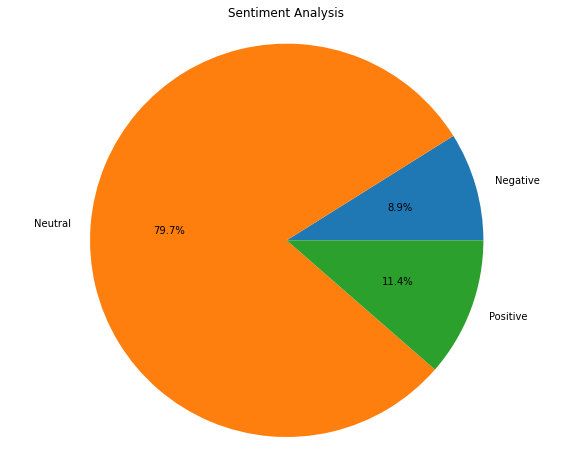

In [ ]:
plt.figure(figsize=(10,8))
plt.pie(value, labels=['Negative','Neutral','Positive'], autopct='%1.1f%%',normalize=True)
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
plt.title('Sentiment Analysis')

In [ ]:
import text2emotion as te

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\sande\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\sande\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sande\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [ ]:
score=te.get_emotion(summary_spacy_wordfrequency)

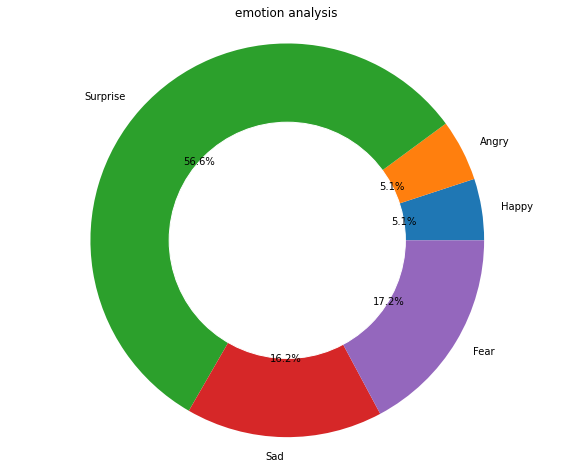

In [ ]:
plt.figure(figsize=(10,8))
plt.pie(score.values(), labels=score.keys(), autopct='%1.1f%%',normalize=True)
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
plt.title('emotion analysis')
circle = plt.Circle( (0,0), 0.6, color='white')
p=plt.gcf()
p.gca().add_artist(circle)
plt.show()

In [ ]:
sentiment= SentimentIntensityAnalyzer()
score=sentiment.polarity_scores(summary_tfidf)
score

{'neg': 0.087, 'neu': 0.811, 'pos': 0.102, 'compound': 1.0}

In [ ]:
if score['compound']>0 and score['compound']<.4:
    print("Neutral")
elif score['compound']>0.4 :
    print("Positve :)")
else:
    print("Negative :(")

Positve :)


In [ ]:
value = score.values()
value
score.pop('compound')

1.0

Text(0.5, 1.0, 'Sentiment Analysis')

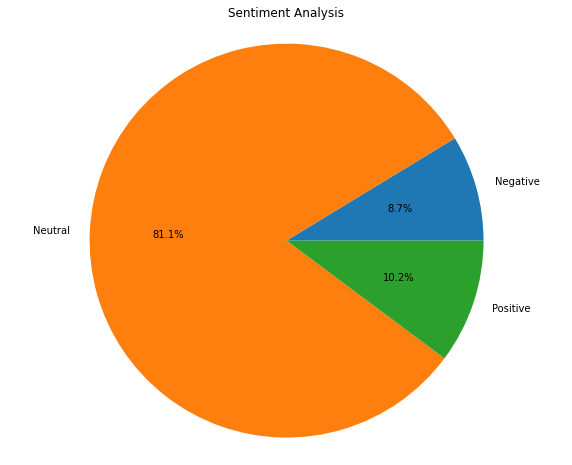

In [ ]:
plt.figure(figsize=(10,8))
plt.pie(value, labels=['Negative','Neutral','Positive'], autopct='%1.1f%%',normalize=True)
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
plt.title('Sentiment Analysis')

In [ ]:
score=te.get_emotion(summary_tfidf)

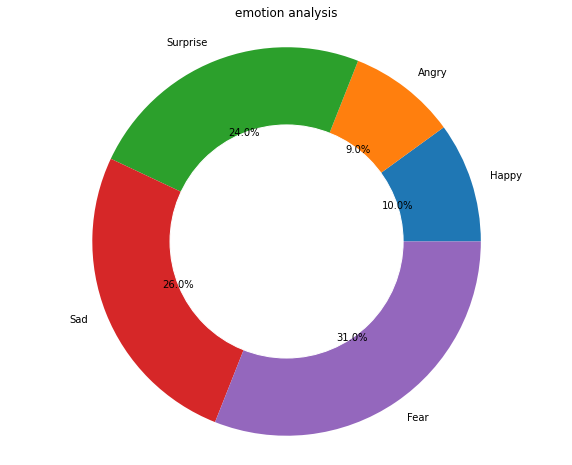

In [ ]:
plt.figure(figsize=(10,8))
plt.pie(score.values(), labels=score.keys(), autopct='%1.1f%%',normalize=True)
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
plt.title('emotion analysis')
circle = plt.Circle( (0,0), 0.6, color='white')
p=plt.gcf()
p.gca().add_artist(circle)
plt.show()